In [1]:
import numpy as np
import tensorflow as tf
import keras
import cv2
from keras.layers import MaxPool2D,Conv2D,UpSampling2D,Input,Dropout
from keras.models import Sequential
from keras.preprocessing.image import img_to_array
import os
from tqdm import tqdm
import re
import matplotlib.pyplot as plt

In [2]:
# to get the files in proper order
def sorted_alphanumeric(data):  
    convert = lambda text: int(text) if text.isdigit() else text.lower()
    alphanum_key = lambda key: [convert(c) for c in re.split('([0-9]+)',key)]
    return sorted(data,key = alphanum_key)
# defining the size of the image
SIZE = 160
color_img = []
path = '../input/landscape-image-colorization/landscape Images/color'
files = os.listdir(path)
files = sorted_alphanumeric(files)
for i in tqdm(files):    
    if i == '6000.jpg':
        break
    else:    
        img = cv2.imread(path + '/'+i,1)
        # open cv reads images in BGR format so we have to convert it to RGB
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        #resizing image
        img = cv2.resize(img, (SIZE, SIZE))
        img = img.astype('float32') / 255.0
        color_img.append(img_to_array(img))


gray_img = []
path = '../input/landscape-image-colorization/landscape Images/gray'
files = os.listdir(path)
files = sorted_alphanumeric(files)
for i in tqdm(files):
     if i == '6000.jpg':
        break
     else: 
        img = cv2.imread(path + '/'+i,1)

        #resizing image
        img = cv2.resize(img, (SIZE, SIZE))
        img = img.astype('float32') / 255.0
        gray_img.append(img_to_array(img))
         
   

 84%|████████▍ | 6000/7129 [00:50<00:09, 117.84it/s]


In [3]:
# defining function to plot images pair
def plot_images(color,grayscale):
    plt.figure(figsize=(15,15))
    plt.subplot(1,3,1)
    plt.title('Color Image', color = 'green', fontsize = 20)
    plt.imshow(color)
    plt.subplot(1,3,2)
    plt.title('Grayscale Image ', color = 'black', fontsize = 20)
    plt.imshow(grayscale)
   
    plt.show()

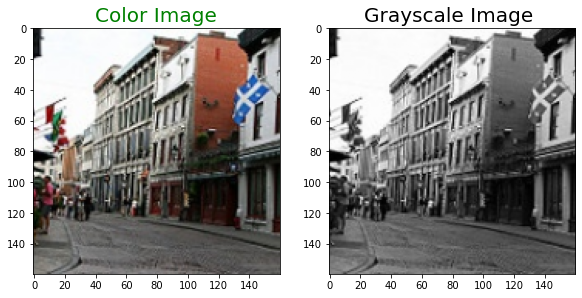

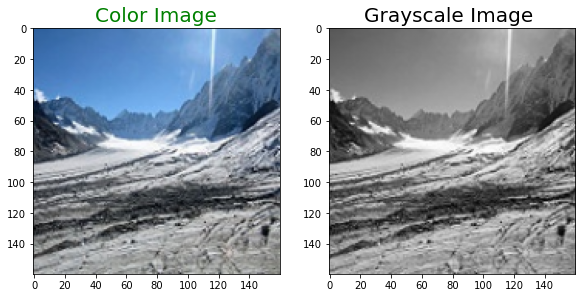

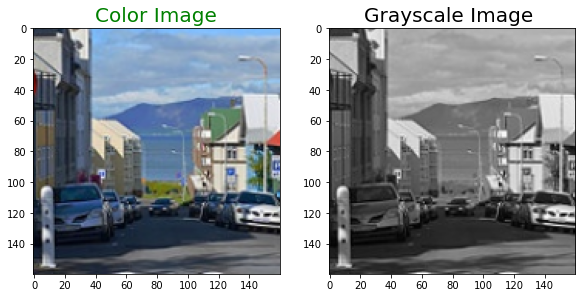

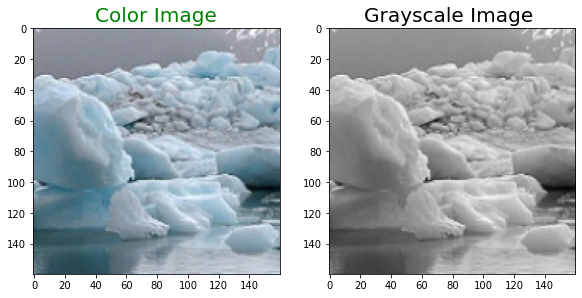

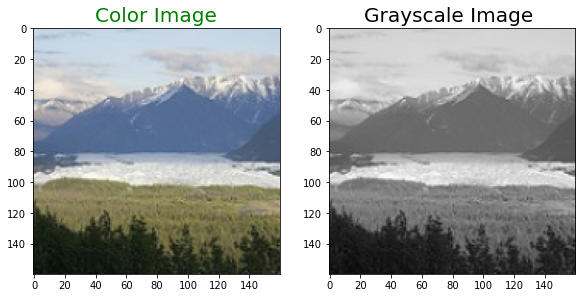

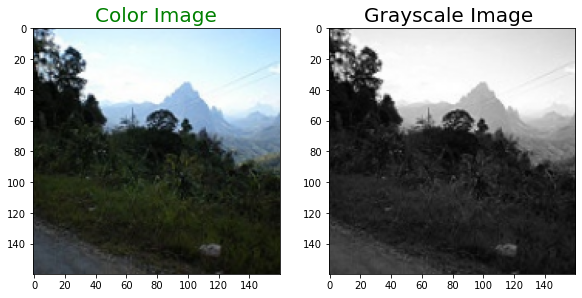

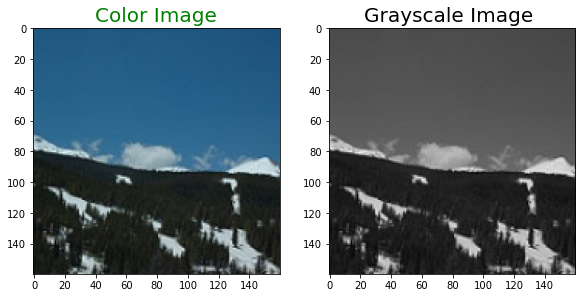

In [4]:
for i in range(3,10):
     plot_images(color_img[i],gray_img[i])

In [5]:
train_gray_image = gray_img[:5500]
train_color_image = color_img[:5500]

test_gray_image = gray_img[5500:]
test_color_image = color_img[5500:]
# reshaping
train_g = np.reshape(train_gray_image,(len(train_gray_image),SIZE,SIZE,3))
train_c = np.reshape(train_color_image, (len(train_color_image),SIZE,SIZE,3))
print('Train color image shape:',train_c.shape)


test_gray_image = np.reshape(test_gray_image,(len(test_gray_image),SIZE,SIZE,3))
test_color_image = np.reshape(test_color_image, (len(test_color_image),SIZE,SIZE,3))
print('Test color image shape',test_color_image.shape)

Train color image shape: (5500, 160, 160, 3)
Test color image shape (500, 160, 160, 3)


In [6]:
from keras import layers
def down(filters , kernel_size, apply_batch_normalization = True):
    downsample = tf.keras.models.Sequential()
    downsample.add(layers.Conv2D(filters,kernel_size,padding = 'same', strides = 2))
    if apply_batch_normalization:
        downsample.add(layers.BatchNormalization())
    downsample.add(keras.layers.LeakyReLU())
    return downsample


def up(filters, kernel_size, dropout = False):
    upsample = tf.keras.models.Sequential()
    upsample.add(layers.Conv2DTranspose(filters, kernel_size,padding = 'same', strides = 2))
    if dropout:
        upsample.dropout(0.2)
    upsample.add(keras.layers.LeakyReLU())
    return upsample


In [7]:
def model():
    inputs = layers.Input(shape= [160,160,3])
    d1 = down(128,(3,3),False)(inputs)
    d2 = down(128,(3,3),False)(d1)
    d3 = down(256,(3,3),True)(d2)
    d4 = down(512,(3,3),True)(d3)
    
    d5 = down(512,(3,3),True)(d4)
    #upsampling
    u1 = up(512,(3,3),False)(d5)
    u1 = layers.concatenate([u1,d4])
    u2 = up(256,(3,3),False)(u1)
    u2 = layers.concatenate([u2,d3])
    u3 = up(128,(3,3),False)(u2)
    u3 = layers.concatenate([u3,d2])
    u4 = up(128,(3,3),False)(u3)
    u4 = layers.concatenate([u4,d1])
    u5 = up(3,(3,3),False)(u4)
    u5 = layers.concatenate([u5,inputs])
    output = layers.Conv2D(3,(2,2),strides = 1, padding = 'same')(u5)
    return tf.keras.Model(inputs=inputs, outputs=output)

In [6]:
# from tensorflow.keras.models import load_model

# savedModel=load_model('/kaggle/input/colorizationautoenc/colorModel.h5')
# savedModel.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 160, 160, 3) 0                                            
__________________________________________________________________________________________________
sequential (Sequential)         (None, 80, 80, 128)  3584        input_1[0][0]                    
__________________________________________________________________________________________________
sequential_1 (Sequential)       (None, 40, 40, 128)  147584      sequential[0][0]                 
__________________________________________________________________________________________________
sequential_2 (Sequential)       (None, 20, 20, 256)  296192      sequential_1[0][0]               
_______________________________________________________________________________________

In [8]:
model = model()
model.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 160, 160, 3) 0                                            
__________________________________________________________________________________________________
sequential (Sequential)         (None, 80, 80, 128)  3584        input_1[0][0]                    
__________________________________________________________________________________________________
sequential_1 (Sequential)       (None, 40, 40, 128)  147584      sequential[0][0]                 
__________________________________________________________________________________________________
sequential_2 (Sequential)       (None, 20, 20, 256)  296192      sequential_1[0][0]               
_______________________________________________________________________________________

In [9]:
model.compile(optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001), loss = 'mean_absolute_error',
              metrics = ['acc'])

model.fit(train_g, train_c, epochs = 50,batch_size = 50)

Epoch 1/50
110/110 [==============================] - 16s 142ms/step - loss: 0.1100 - acc: 0.3958
Epoch 2/50
110/110 [==============================] - 16s 144ms/step - loss: 0.0651 - acc: 0.4525
Epoch 3/50
110/110 [==============================] - 16s 143ms/step - loss: 0.0583 - acc: 0.4780
Epoch 4/50
110/110 [==============================] - 16s 143ms/step - loss: 0.0551 - acc: 0.4861
Epoch 5/50
110/110 [==============================] - 16s 142ms/step - loss: 0.0528 - acc: 0.4946
Epoch 6/50
110/110 [==============================] - 16s 143ms/step - loss: 0.0515 - acc: 0.4989
Epoch 7/50
110/110 [==============================] - 16s 143ms/step - loss: 0.0500 - acc: 0.5092
Epoch 8/50
110/110 [==============================] - 16s 144ms/step - loss: 0.0489 - acc: 0.5172
Epoch 9/50
110/110 [==============================] - 16s 143ms/step - loss: 0.0481 - acc: 0.5220
Epoch 10/50
110/110 [==============================] - 16s 144ms/step - loss: 0.0470 - acc: 0.5351
Epoch 11/50
110/110

In [ ]:
model.evaluate(test_gray_image,test_color_image)

In [10]:
model.save('/kaggle/working/colorModel.h5')
model.save_weights('/kaggle/working/colorModelweights.h5')



In [ ]:
# model = create_model()
# model.load_weights('/kaggle/input/colorizationautoenc/checkpoint')

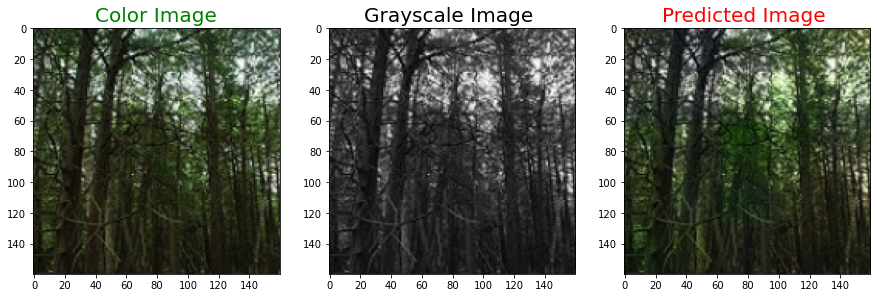

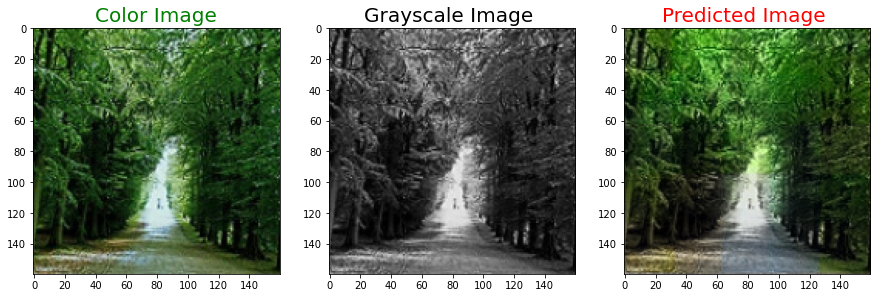

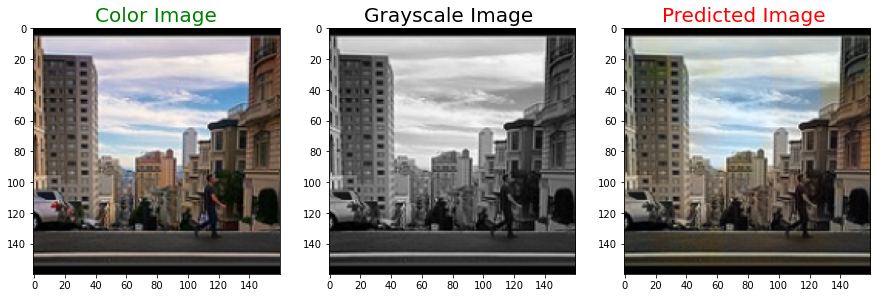

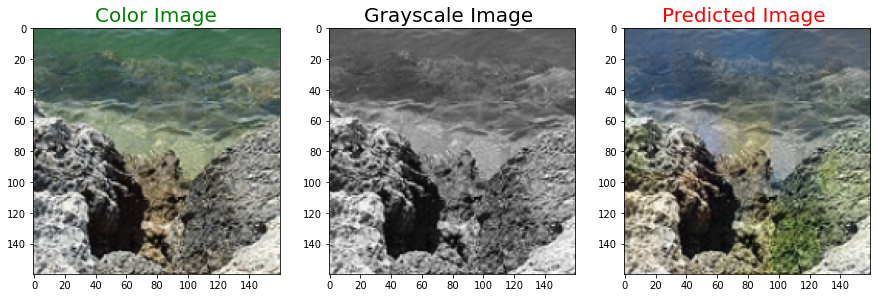

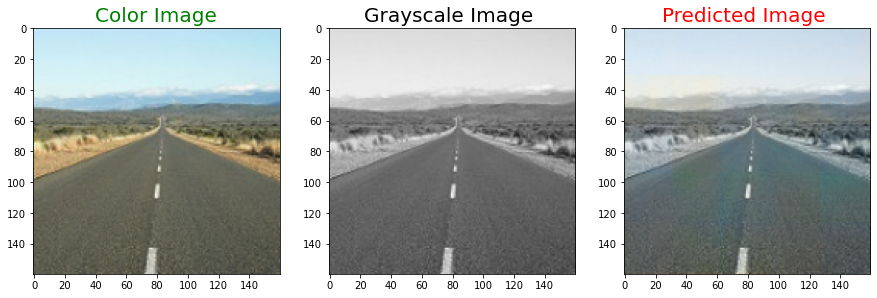

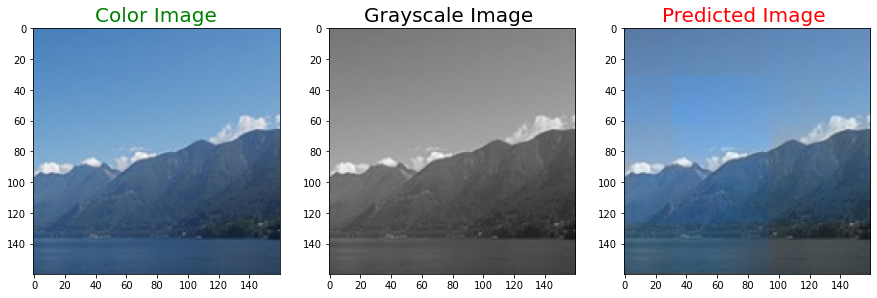

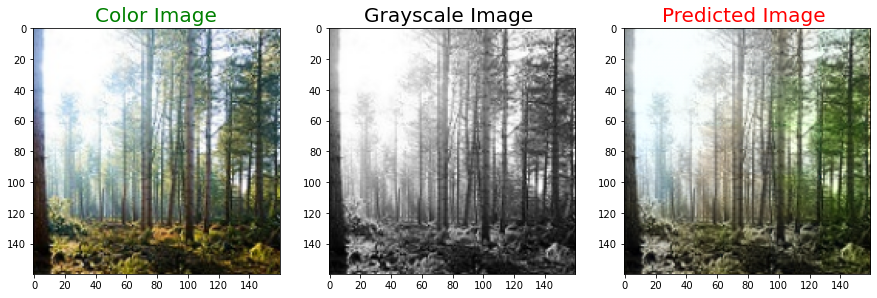

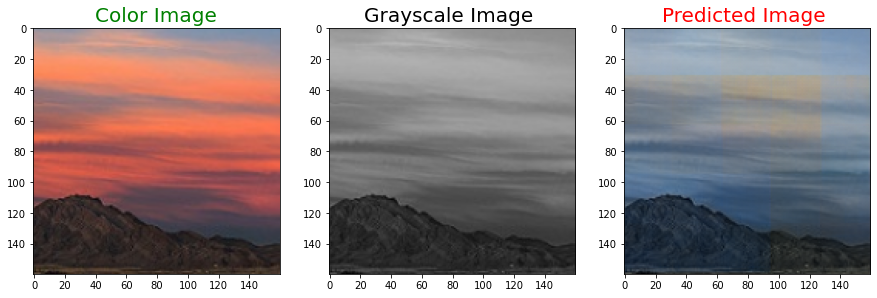

In [11]:
# defining function to plot images pair
def plot_images(color,grayscale,predicted):
    plt.figure(figsize=(15,15))
    plt.subplot(1,3,1)
    plt.title('Color Image', color = 'green', fontsize = 20)
    plt.imshow(color)
    plt.subplot(1,3,2)
    plt.title('Grayscale Image ', color = 'black', fontsize = 20)
    plt.imshow(grayscale)
    plt.subplot(1,3,3)
    plt.title('Predicted Image ', color = 'Red', fontsize = 20)
    plt.imshow(predicted)
   
    plt.show()

for i in range(50,58):
    predicted = np.clip(model.predict(test_gray_image[i].reshape(1,SIZE, SIZE,3)),0.0,1.0).reshape(SIZE, SIZE,3)
    plot_images(test_color_image[i],test_gray_image[i],predicted)

 

In [13]:
import os
test_img = os.listdir('/kaggle/input/colorizationautoenc/Archive')
test_img

['HD-wallpaper-road-landscape-aesthetic-black-and-white-ultra-black-and-white-sunrise-nature-beautiful-landscape-bird-scenery-trees-perspective-scene-dawn-road-graphy-dorset-monochrome-straight-crow.jpg',
 'beautiful-landscape-sky-tres-path-black-white-photography-panorama-autsria-nature-beautiful-landscape-sky-tres-225069095.jpg',
 'images (1).jpeg',
 'pexels-pixabay-276374.jpg',
 'backwaters-kerala-medium-format-film-analog-photography-kodak-trix-india.jpg.jpg']

unzip:  cannot find or open /kaggle/input/colorizationautoenc/Archive, /kaggle/input/colorizationautoenc/Archive.zip or /kaggle/input/colorizationautoenc/Archive.ZIP.


(160, 160, 3)


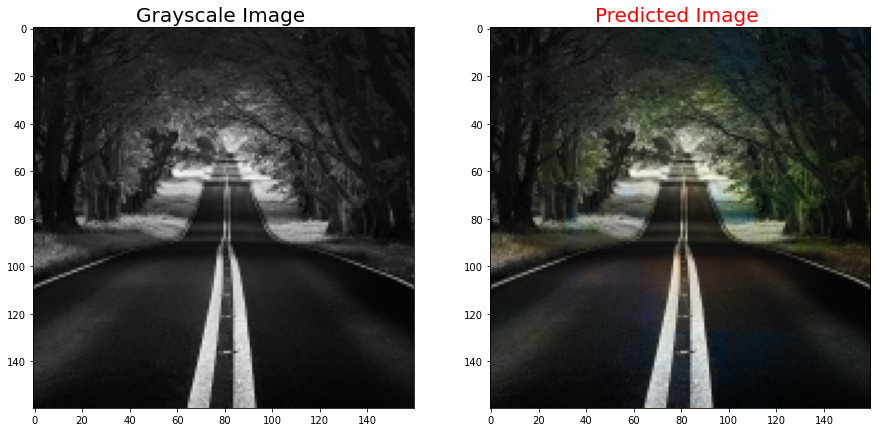

(160, 160, 3)


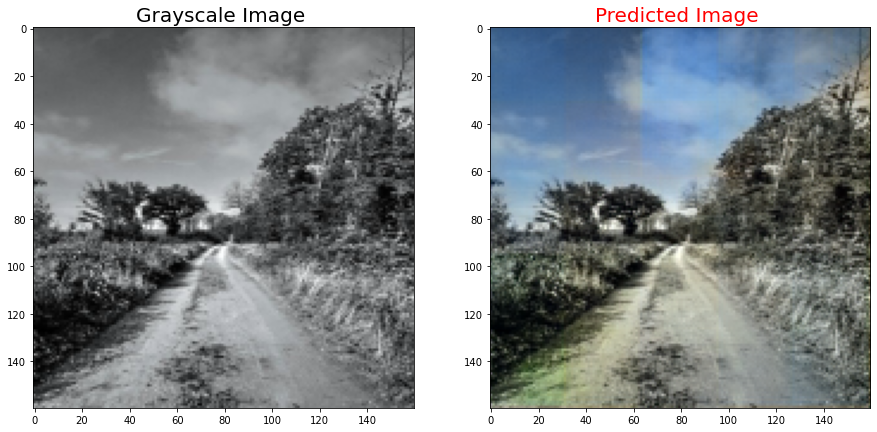

(160, 160, 3)


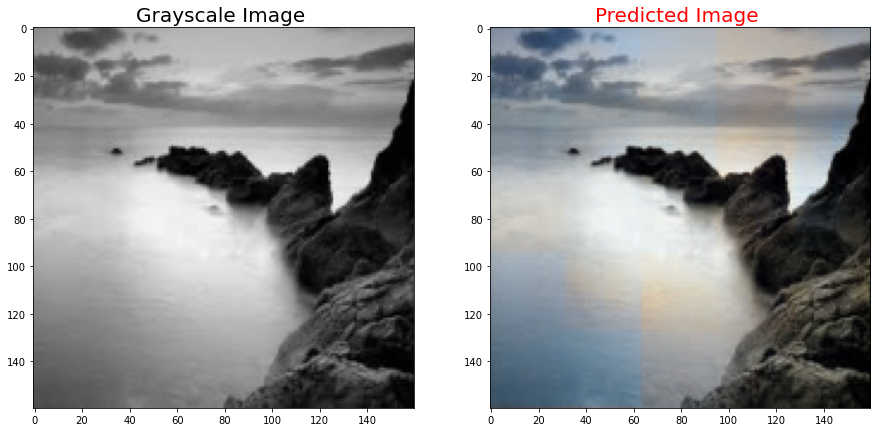

(160, 160, 3)


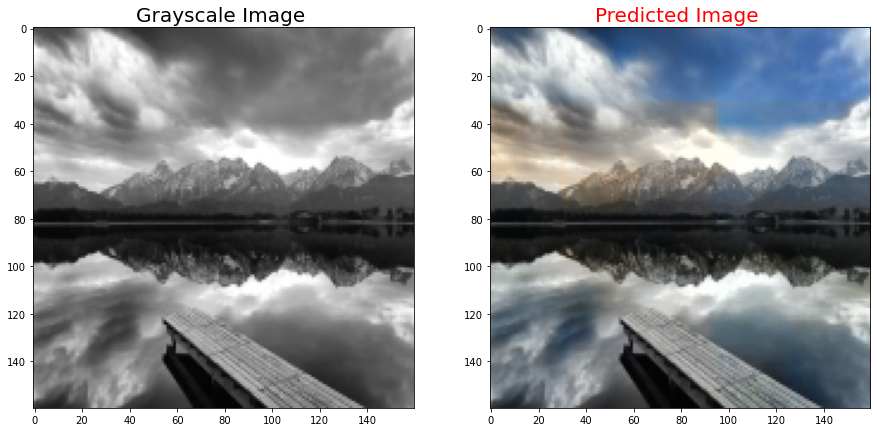

(160, 160, 3)


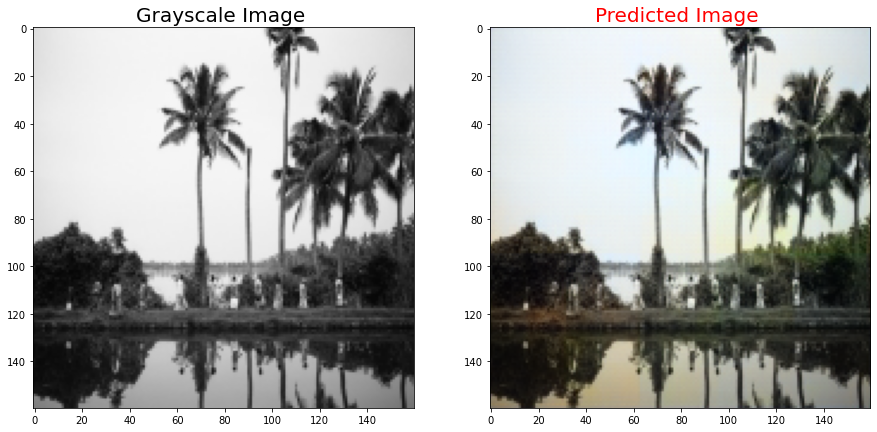

In [15]:
# defining function to plot images pair
import cv2
SIZE = 160

def plot_images(grayscale,predicted):
    plt.figure(figsize=(15,15))
    plt.subplot(1,2,1)

    plt.title('Grayscale Image ', color = 'black', fontsize = 20)
    plt.imshow(grayscale)
    plt.subplot(1,2,2)
    plt.title('Predicted Image ', color = 'Red', fontsize = 20)
    plt.imshow(predicted)   
    plt.show()

for i in test_img:
    t_img = cv2.imread('/kaggle/input/colorizationautoenc/Archive/'+i)
    t_img = cv2.resize(t_img, (160,160), interpolation = cv2.INTER_AREA)
    t_img = t_img.astype('float32') / 255.0

    print(t_img.shape)
    predicted = np.clip(model.predict(t_img.reshape(1,t_img.shape[0],  t_img.shape[1],3)),0.0,1.0).reshape(SIZE, SIZE,3)
    
#     predicted = savedModel.predict(t_img)
    plot_images(t_img,predicted)


In [55]:
import cv2
input_video_path = "/kaggle/input/colorizationautoenc/videoplayback.mp4"

output_video_path = "/kaggle/working/videoch.mp4"


cap = cv2.VideoCapture(input_video_path)

fps = int(cap.get(cv2.CAP_PROP_FPS))
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter(output_video_path, fourcc, fps, (width, height))


while cap.isOpened():
    ret, frame = cap.read()

    if ret:

        input_data = frame
        input_data = input_data.astype('float32') / 255.0

        # Pass the frame through the TensorFlow model to get the output
        t_img = cv2.resize(input_data, (160,160), interpolation = cv2.INTER_AREA)
#         plt.imshow(t_img)
        t_img = t_img.astype('float32') / 255.0
#         plt.imshow(t_img)
        output_data = np.clip(model.predict(t_img.reshape(1,t_img.shape[0],  t_img.shape[1],3)),0.0,1.0).reshape(SIZE, SIZE,3)
#         output_data = model.predict(input_data)

        # Convert the output data back to an image format
        output_data = output_data * 255.0
        output_data = output_data.astype('uint8')

        out.write(output_data)

    else:
        break

cap.release()
out.release()

In [41]:

cap = cv2.VideoCapture('/kaggle/input/colorizationautoenc/videoplayback.mp4')

# Get the frames per second (fps) and frame size of the input video
fps = int(cap.get(cv2.CAP_PROP_FPS))
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter(output_video_path, fourcc, fps, (width, height))


t_arr = []

while cap.isOpened():
    ret, frame = cap.read()

    if ret:

#         input_data = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
#         input_data = np.expand_dims(frame, axis=0)
        t_arr.append(frame)
    else:
        break

print(len(t_arr))

# for i in range(10):
#     plt.imshow(t_arr[i])


# for i in test_img:
#     t_img = cv2.imread('/kaggle/input/colorizationautoenc/Archive/'+i)
#     t_img = cv2.resize(t_img, (160,160), interpolation = cv2.INTER_AREA)
#     t_img = t_img.astype('float32') / 255.0

#     print(t_img.shape)
#     predicted = np.clip(model.predict(t_img.reshape(1,t_img.shape[0],  t_img.shape[1],3)),0.0,1.0).reshape(SIZE, SIZE,3)
cap.release()
out.release()

2704


In [58]:
!pip install sk-video

     |████████████████████████████████| 2.3 MB 4.4 MB/s eta 0:00:01
You should consider upgrading via the '/opt/conda/bin/python3.7 -m pip install --upgrade pip' command.


In [62]:

    
# defining function to plot images pair
import cv2
SIZE = 160

def plot_images(grayscale,predicted):
    plt.figure(figsize=(15,15))
    plt.subplot(1,2,1)

    plt.title('Grayscale Image ', color = 'black', fontsize = 20)
    plt.imshow(grayscale)
    plt.subplot(1,2,2)
    plt.title('Predicted Image ', color = 'Red', fontsize = 20)
    plt.imshow(predicted)   
    plt.show()
pred_arr = []

for t_img in t_arr:
#     t_img = cv2.imread('/kaggle/input/colorizationautoenc/Archive/'+i)
    t_img = cv2.resize(t_img, (160,160), interpolation = cv2.INTER_AREA)
    t_img = t_img.astype('float32') / 255.0

#     print(t_img.shape)
    predicted = np.clip(model.predict(t_img.reshape(1,t_img.shape[0],  t_img.shape[1],3)),0.0,1.0).reshape(SIZE, SIZE,3)
    pred_arr.append(predicted)
    plot_images(t_img,predicted)
print(len(pred_arr))

2704


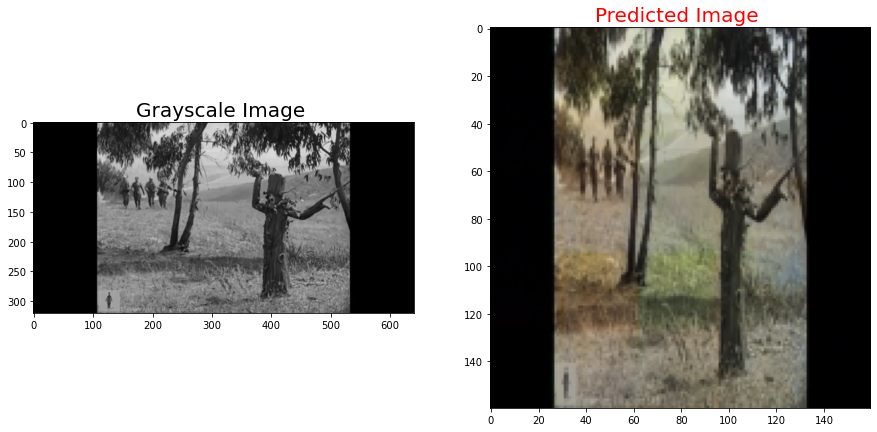

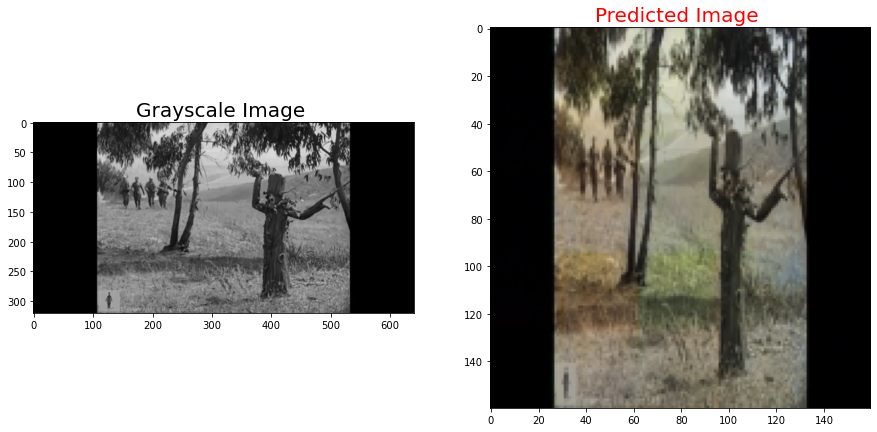

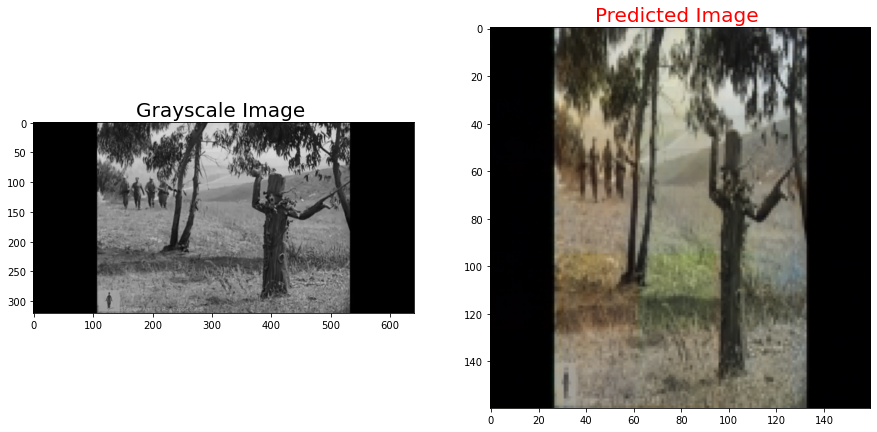

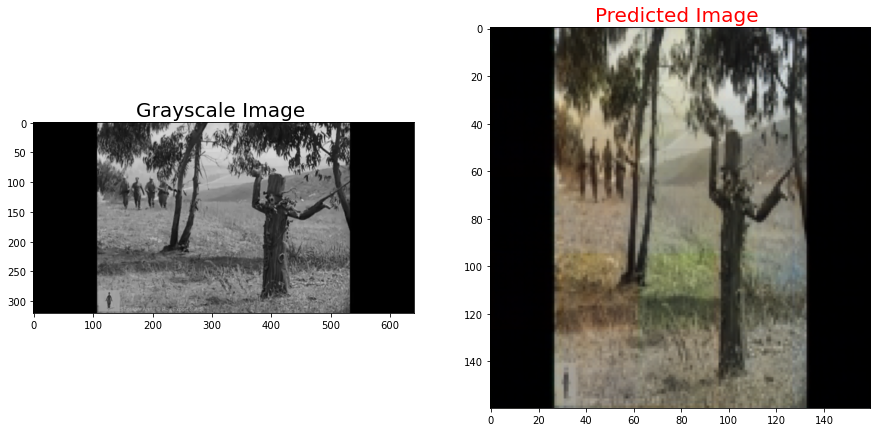

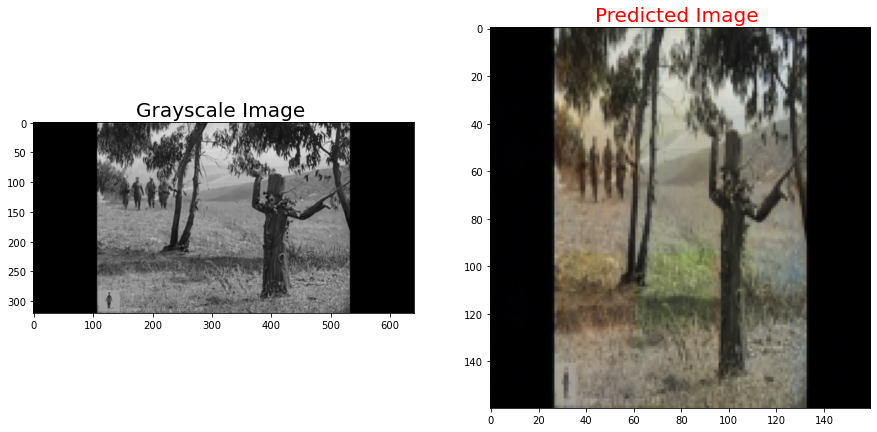

...

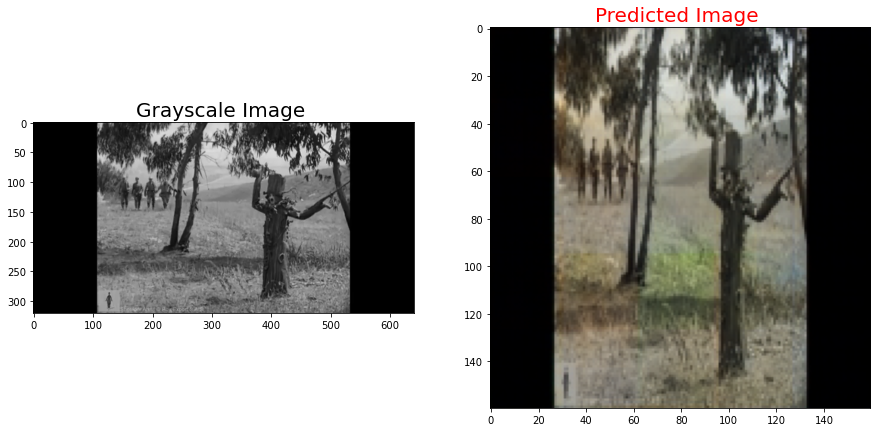

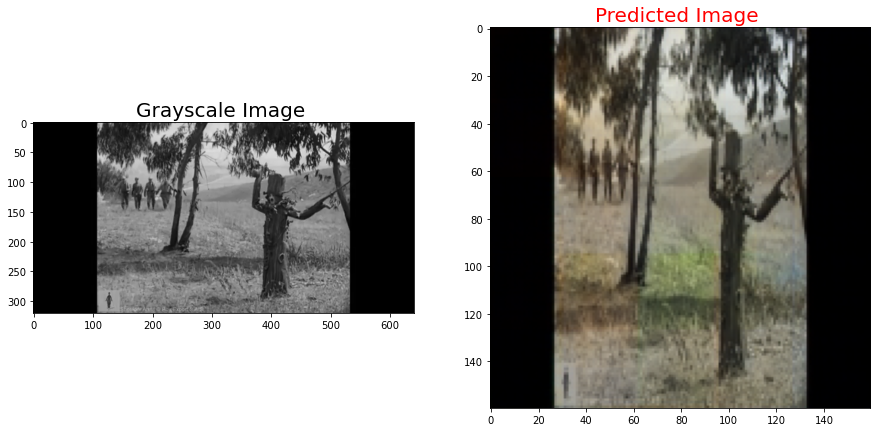

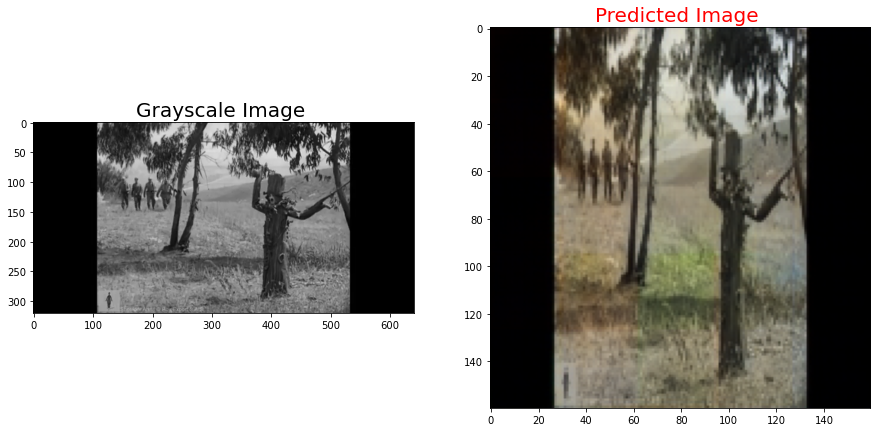

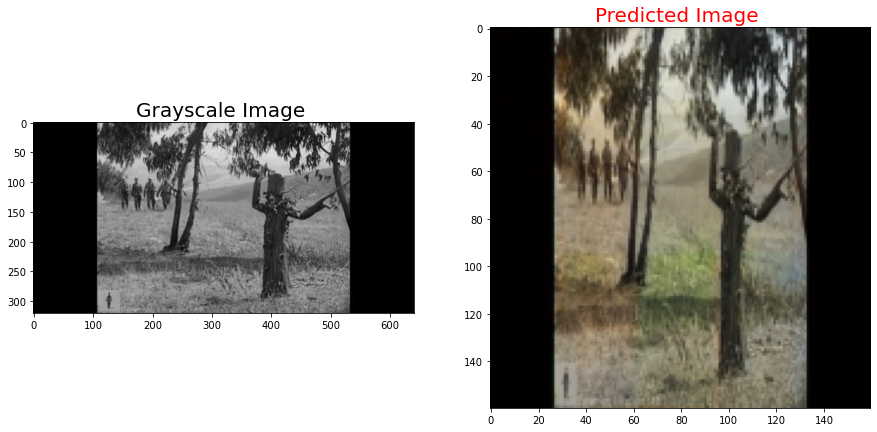

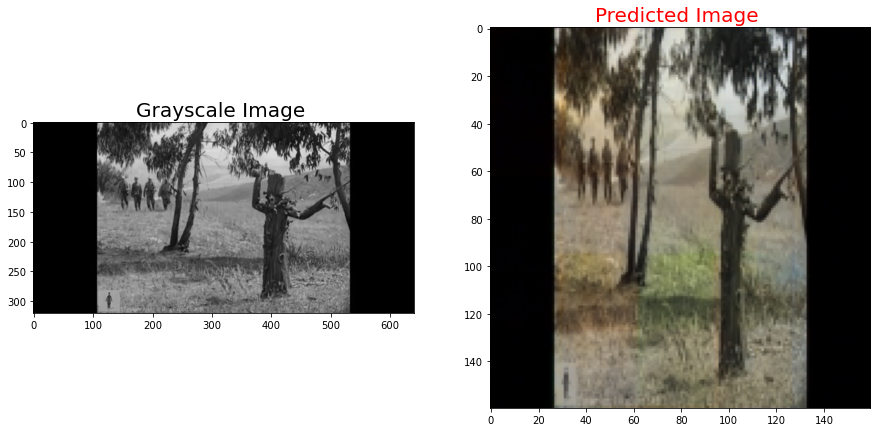

KeyboardInterrupt: 

In [66]:
for timg,pimg in zip(t_arr,pred_arr):
    plot_images(timg,pimg)

In [65]:
import numpy as np
import skvideo.io
npred_arr = []
for vif in pred_arr:
    npred_arr.append(vif*255.0)

skvideo.io.vwrite("/kaggle/working/chaplinColor1.mp4", npred_arr)

In [52]:
frameSize = (160, 160)


fps = int(cap.get(cv2.CAP_PROP_FPS))
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

# Create a VideoWriter object to create the output video file
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter('/kaggle/working/chaplin.mp4', fourcc, fps, (160, 160))

# Loop through the array of images and write them to the video
for img in pred_arr:
    out.write(img)

# Release the video writer and close the output file
out.release()
out.release()

In [31]:
# !rm /kaggle/working/video.mp4

In [ ]:
#https://docs.google.com/presentation/d/e/2PACX-1vTO_IYzi4LdUQOEA6D---UpV6AU2og8p06Y2RT7ExtTb5TbNUyvWtRPjzflPOpLfkGfSinvi5cugxxX/pub?start=false&loop=false&delayms=3000

In [64]:
from IPython.display import HTML
from base64 import b64encode

def play(filename):
    html = ''
    video = open(filename,'rb').read()
    src = 'data:video/mp4;base64,' + b64encode(video).decode()
    html += '<video width=1000 controls autoplay loop><source src="%s" type="video/mp4"></video>' % src 
    return HTML(html)

play('/kaggle/input/colorizationautoenc/videoplayback.mp4')